<a href="https://colab.research.google.com/github/mahu0926/MOF_ML/blob/main/(Updated)_Carbon_Uptake_Pressure_0_15_bar_Temperature_298K.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Data Preparation

In [ ]:
# mounting google drive
import pandas as pd
import numpy as np

from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# loading csv file into dataframe
path = '/content/drive/MyDrive/Highschool /11th Grade/Research/all_MOFs_screening_data.csv'
df_mof = pd.read_csv(path)

In [ ]:
df_mof.loc[df_mof['CO2_uptake_error_P0.15bar_T298K [mmol/g]'] <0].count()

MOFname                                                        0
CO2_uptake_P0.15bar_T298K [mmol/g]                             0
CO2_uptake_error_P0.15bar_T298K [mmol/g]                       0
heat_adsorption_CO2_P0.15bar_T298K [kcal/mol]                  0
heat_adsorption_error_CO2_P0.15bar_T298K [kcal/mol]            0
excess_CO2_uptake_P0.15bar_T298K [mmol/g]                      0
CO2_uptake_P0.10bar_T363K [mmol/g]                             0
CO2_uptake_error_P0.10bar_T363K [mmol/g]                       0
heat_adsorption_CO2_P0.10bar_T363K [kcal/mol]                  0
heat_adsorption_error_CO2_P0.10bar_T363K [kcal/mol]            0
excess_CO2_uptake_P0.10bar_T363K [mmol/g]                      0
CO2_uptake_P0.70bar_T413K [mmol/g]                             0
CO2_uptake_error_P0.70bar_T413K [mmol/g]                       0
heat_adsorption_CO2_P0.70bar_T413K [kcal/mol]                  0
heat_adsorption_error_CO2_P0.70bar_T413K [kcal/mol]            0
excess_CO2_uptake_P0.70ba

In [ ]:
# cleaning the dataset of null values, etc.
def clean_dataset(df):
    assert isinstance(df, pd.DataFrame), "df needs to be a pd.DataFrame"
    df.dropna(inplace=True)
    indices_to_keep = ~df.isin([np.nan, np.inf, -np.inf]).any(1)
    #return df[indices_to_keep].astype(np.float64)
    return df[indices_to_keep]
df1_mof = clean_dataset(df_mof)

In [ ]:
# label encoding
from sklearn.preprocessing import LabelEncoder
lb_encoder = LabelEncoder()
df1_mof['topology_code'] = lb_encoder.fit_transform(df1_mof['topology'])
df1_mof['functional_groups_code'] = lb_encoder.fit_transform(df1_mof['functional_groups'])

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """


In [ ]:
# Dropping Categorical Columns
categorical_columns = df1_mof.columns[df1_mof.dtypes == object] 
print(categorical_columns)
df1_mof = df1_mof.drop(categorical_columns, axis=1)
col = df1_mof.columns

Index(['MOFname', 'functional_groups', 'topology'], dtype='object')


In [ ]:
# Standardize the dataset; This is very important before you apply PCA
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
sc.fit(df1_mof)
df1_mof = sc.transform(df1_mof)
type(df1_mof)

numpy.ndarray

In [ ]:
# Convert from array to dataframe
df1_mof = pd.DataFrame(df1_mof, columns=col)

In [ ]:
# selecting required features
df2_mof = df1_mof[['CO2_uptake_P0.15bar_T298K [mmol/g]', 'volume [A^3]', 'weight [u]', 'surface_area [m^2/g]', 'void_fraction',
       'void_volume [cm^3/g]', 'largest_free_sphere_diameter [A]',
       'largest_included_sphere_along_free_sphere_path_diameter [A]',
       'largest_included_sphere_diameter [A]', 'metal_linker',
       'organic_linker1', 'organic_linker2', 'topology_code',
       'functional_groups_code'
       , 'CO2/N2_selectivity']]

In [ ]:
# taking all the data for the 1st to 3rd quantile
q1 = df2_mof['CO2/N2_selectivity'].quantile(.25)
q3 = df2_mof['CO2/N2_selectivity'].quantile(.75)
col_iqr = q3 - q1
col_max = q3 + 1.5 * col_iqr
col_min = q1 - 1.5 * col_iqr

# Filter data without outliers and ignoring nan
filtered_df = df2_mof[(df2_mof['CO2/N2_selectivity'] <= col_max) & (df2_mof['CO2/N2_selectivity'] >= col_min)]

In [ ]:
filtered_df.describe()

,CO2_uptake_P0.15bar_T298K [mmol/g],volume [A^3],weight [u],surface_area [m^2/g],void_fraction,void_volume [cm^3/g],largest_free_sphere_diameter [A],largest_included_sphere_along_free_sphere_path_diameter [A],largest_included_sphere_diameter [A],metal_linker,organic_linker1,organic_linker2,topology_code,functional_groups_code,CO2/N2_selectivity
count,289954.000000,289954.000000,289954.000000,289954.000000,289954.000000,289954.000000,289954.000000,289954.000000,289954.000000,289954.000000,289954.000000,289954.000000,289954.000000,289954.000000,289954.000000
mean,-0.209443,0.051221,0.025221,0.145453,0.149989,0.093794,0.121056,0.127016,0.121386,-0.054136,0.005146,0.015723,0.010917,-0.012323,-0.061999
std,0.616575,1.034423,1.030626,0.924832,0.917963,1.002040,0.966437,0.954725,0.965914,0.969165,0.999190,0.992924,0.902456,0.996983,0.085737
min,-0.981135,-0.775718,-1.182999,-1.724785,-7.224424,-1.073342,-2.615602,-2.655113,-2.587841,-0.895359,-1.023117,-1.984179,-2.786672,-1.684966,-0.194122
25%,-0.607118,-0.496585,-0.624661,-0.530373,-0.520917,-0.613040,-0.612623,-0.566308,-0.617386,-0.547265,-0.758280,-0.640352,-0.352761,-0.792091,-0.126516
50%,-0.424505,-0.308763,-0.358573,0.151068,0.199837,-0.181240,0.001976,0.005468,0.004715,-0.199170,-0.228606,0.031561,0.255717,-0.064904,-0.092147
75%,-0.033895,0.062075,0.219953,0.840553,0.857453,0.513681,0.696721,0.713854,0.694562,-0.199170,0.389347,0.415512,0.255717,0.864791,-0.022466
max,6.046474,26.794167,22.975522,3.152368,2.513727,11.430585,9.168640,6.904017,9.190136,2.933680,4.097065,3.583104,3.298107,1.987789,0.224182


In [ ]:
filtered_df.loc[filtered_df['CO2_uptake_P0.15bar_T298K [mmol/g]'] > 0].count()

CO2_uptake_P0.15bar_T298K [mmol/g]                             68634
volume [A^3]                                                   68634
weight [u]                                                     68634
surface_area [m^2/g]                                           68634
void_fraction                                                  68634
void_volume [cm^3/g]                                           68634
largest_free_sphere_diameter [A]                               68634
largest_included_sphere_along_free_sphere_path_diameter [A]    68634
largest_included_sphere_diameter [A]                           68634
metal_linker                                                   68634
organic_linker1                                                68634
organic_linker2                                                68634
topology_code                                                  68634
functional_groups_code                                         68634
CO2/N2_selectivity                

In [ ]:
# Split the data
from sklearn.model_selection import train_test_split
#X_train, X_test, y_train, y_test = X_train, X_test, y_train, y_test = train_test_split(df2_mof[df2_mof.columns[df2_mof.columns != 'CO2_uptake_P0.15bar_T298K [mmol/g]']],
#                   df2_mof['CO2_uptake_P0.15bar_T298K [mmol/g]'], test_size=0.25, random_state=1)
X_train, X_test, y_train, y_test = X_train, X_test, y_train, y_test = train_test_split(filtered_df[filtered_df.columns[filtered_df.columns != 'CO2_uptake_P0.15bar_T298K [mmol/g]']],
                  filtered_df['CO2_uptake_P0.15bar_T298K [mmol/g]'], test_size=0.25, random_state=1)

In [ ]:
da_mof = df_mof.loc[df_mof['CO2/N2_selectivity'] <200]
da_mof = da_mof[['CO2_uptake_P0.15bar_T298K [mmol/g]', 'volume [A^3]', 'weight [u]', 'surface_area [m^2/g]', 'void_fraction',
       'void_volume [cm^3/g]', 'largest_free_sphere_diameter [A]',
       'largest_included_sphere_along_free_sphere_path_diameter [A]',
       'largest_included_sphere_diameter [A]', 'metal_linker',
       'organic_linker1', 'organic_linker2', 'topology',
       'functional_groups'
       , 'CO2/N2_selectivity']]
da_mof.describe()

,CO2_uptake_P0.15bar_T298K [mmol/g],volume [A^3],weight [u],surface_area [m^2/g],void_fraction,void_volume [cm^3/g],largest_free_sphere_diameter [A],largest_included_sphere_along_free_sphere_path_diameter [A],largest_included_sphere_diameter [A],metal_linker,organic_linker1,organic_linker2,CO2/N2_selectivity
count,319170.000000,319170.000000,319170.000000,319170.000000,319170.000000,319170.000000,319170.000000,319170.000000,319170.000000,319170.000000,319170.000000,319170.000000,319170.000000
mean,0.522108,6302.356624,2098.695308,2859.872522,0.418106,0.828799,10.599680,7.408023,10.482659,3.571332,12.588981,21.671639,13.843560
std,0.531609,8124.586910,1774.940606,1657.451092,0.196169,0.771874,4.432497,3.164960,4.434923,2.872269,11.326390,10.416959,15.913898
min,0.000008,-1.000000,-1.000000,-1.000000,-1.000000,0.000000,-1.000000,-1.000000,-1.000000,1.000000,1.000000,1.000000,0.001734
25%,0.206847,2072.495300,990.133680,1589.280000,0.268780,0.273800,7.212955,5.087950,7.083077,2.000000,4.000000,15.000000,5.204075
50%,0.322615,3535.682936,1456.901980,2899.000000,0.429260,0.610400,9.994600,7.079215,9.889890,3.000000,10.000000,22.000000,8.299440
75%,0.610560,6019.752299,2407.826205,4127.390000,0.573420,1.153000,13.322383,9.399767,13.208187,3.000000,17.000000,26.000000,15.505914
max,5.955197,223964.854408,42873.393600,8085.620000,0.911340,9.651600,51.248840,29.264110,51.248840,12.000000,59.000000,59.000000,199.947103


# Data Analysis


In [ ]:
import plotly.express as px
fig = px.scatter(da_mof, x="CO2/N2_selectivity", y="CO2_uptake_P0.15bar_T298K [mmol/g]",  render_mode='webgl')
#width=2000, height=4000,
fig.show()

In [ ]:
import plotly.express as px
fig = px.scatter(da_mof, x="surface_area [m^2/g]", y="CO2_uptake_P0.15bar_T298K [mmol/g]", width=800, height=800, render_mode='webgl')
fig.show()

In [ ]:
fig = px.scatter(da_mof, x="weight [u]", y="CO2_uptake_P0.15bar_T298K [mmol/g]",  width=800, height=800, render_mode='webgl')
fig.show()

In [ ]:
fig = px.scatter(da_mof, x="void_fraction", y="CO2_uptake_P0.15bar_T298K [mmol/g]",  width=800, height=800, render_mode='webgl')
fig.show()

In [ ]:
fig = px.scatter(da_mof, x="void_volume [cm^3/g]", y="CO2_uptake_P0.15bar_T298K [mmol/g]",  width=800, height=800, render_mode='webgl')
fig.show()

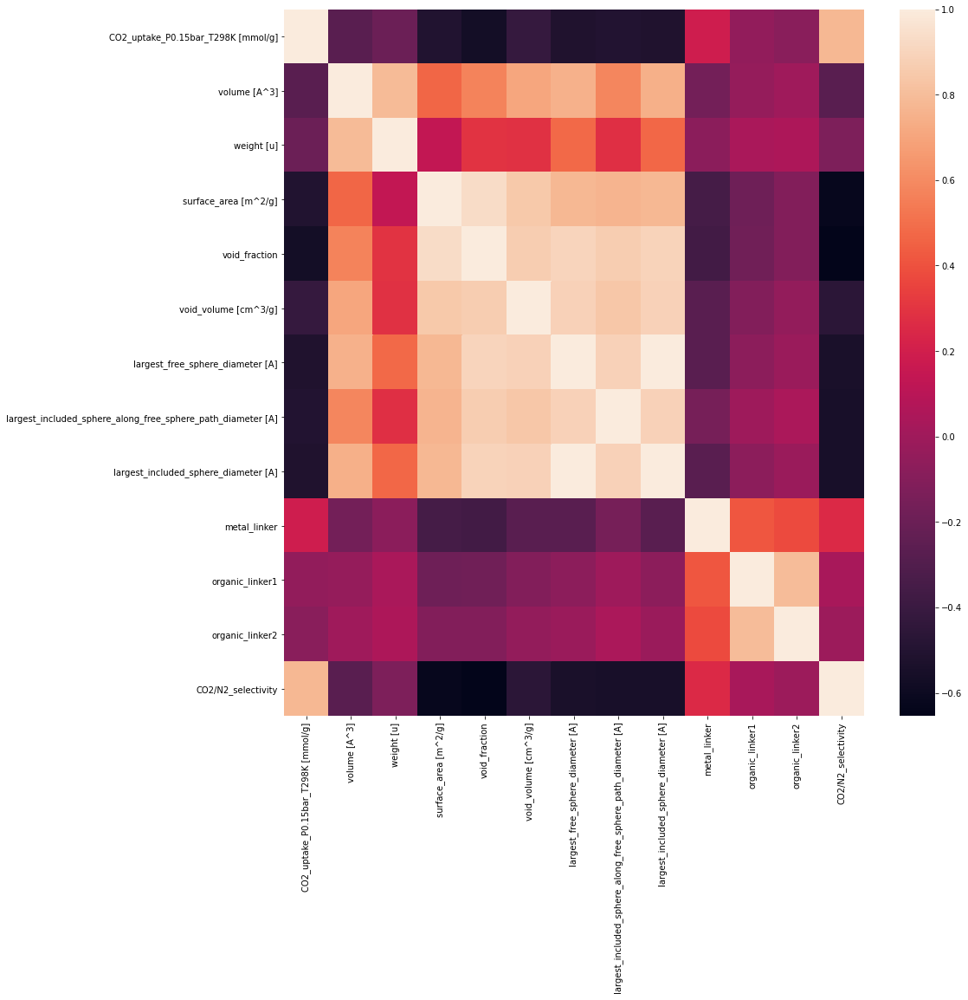

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
plt.figure(figsize=(15, 15))
sns.heatmap(da_mof.corr());


In [ ]:
da1_mof= da_mof['CO2/N2_selectivity','surface_area [m^2/g]']

KeyError: ignored

# Linear Regression

In [ ]:
# fit the linear model to training data
from sklearn.linear_model import LinearRegression
model = LinearRegression()
model.fit(X_train, y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [ ]:
# test the model with test data
pred_CO2_uptake_P015bar_T298K = model.predict(X_test)
type(pred_CO2_uptake_P015bar_T298K)

numpy.ndarray

In [ ]:
# measure the error from predicted value vs. actual value
from sklearn.metrics import mean_squared_error
mean_squared_error(y_test, pred_CO2_uptake_P015bar_T298K)

0.1270142820264

# Lasso Regression

In [ ]:
# fit train data with lasso regression model 
from sklearn.linear_model import Lasso
lasso = Lasso(alpha=0.05, max_iter=10e5)
lasso.fit(X_train, y_train) #fit model to training data
train_score = lasso.score(X_train, y_train)

In [ ]:
# test lasso regression with test data
test_score = lasso.score(X_test, y_test)
coeff_used = np.sum(lasso.coef_!=0)
y_pred = lasso.predict(X_test)

In [ ]:
# measure the error
from sklearn.metrics import mean_squared_error
mean_squared_error(y_test, y_pred)

0.2701830128180997

Text(0, 0.5, 'Coefficients')

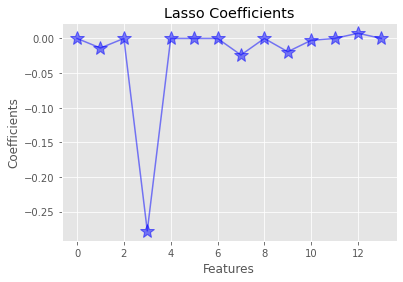

In [ ]:
# plotting lasso coefficients

import matplotlib.pyplot as plt
plt.style.use('ggplot')
plt.plot(lasso.coef_, alpha=0.5, marker='*', markersize=15, color='b', label=r'Lasso; $\alpha=1$', zorder=7)
plt.title("Lasso Coefficients")
plt.xlabel("Features")
plt.ylabel("Coefficients")

In [ ]:
X_train.iloc[:, lasso.coef_ !=0]

,weight [u],void_fraction,largest_included_sphere_diameter [A],organic_linker1,organic_linker2,functional_groups_code
283400,1.188900,0.549681,0.311256,0.830742,0.319524,0.956840
194860,-0.837287,0.101429,-0.448221,-0.140327,0.127549,0.156014
209173,3.596411,1.050360,1.582248,-0.934838,-0.736340,-1.316770
294090,0.513785,1.322226,1.128178,-0.140327,-0.160414,0.340112
124429,-0.488860,-0.629643,-0.574087,-0.140327,-1.024303,0.984455
...,...,...,...,...,...,...
44440,-0.633872,-1.211281,-1.169155,-0.316885,-0.160414,-1.132672
145757,-0.695000,-1.831385,-1.516015,-0.228606,-1.024303,-0.055699
100693,-0.842642,-0.340251,-1.121075,-0.670001,-1.312265,0.892406
296236,-0.153356,0.577958,0.462202,-0.934838,-1.312265,-1.059033


# PCA

In [ ]:
# Perform PCA
from sklearn.decomposition import PCA
pca = PCA(n_components=0.95)

In [ ]:
pca.fit(df2_mof)
df2_mof_pca = pca.transform(df2_mof)
df2_mof_pca.shape

(319290, 9)

In [ ]:
pca.fit(X_train)
X_train_pca = pca.transform(X_train)
X_test_pca = pca.transform(X_test)

In [ ]:
print(pca.explained_variance_ratio_.size)

7


Text(0.5, 1.0, 'Component wise and Cumulative Explained Variance')

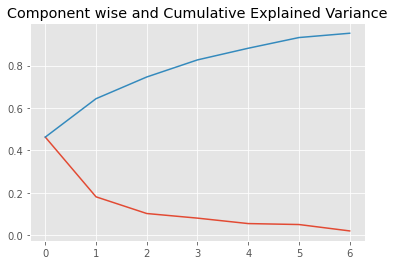

In [ ]:
plt.plot(range(pca.explained_variance_ratio_.size), pca.explained_variance_ratio_)
plt.plot(range(pca.explained_variance_ratio_.size), np.cumsum(pca.explained_variance_ratio_))
plt.title("Component wise and Cumulative Explained Variance")

In [ ]:
pca.components_[3,:]

array([ 1.24821425e-02,  6.76131107e-02, -7.13983315e-02,  1.08719144e-02,
       -3.15941092e-02,  9.38391451e-03,  7.85819854e-04,  9.51543063e-03,
        2.02500661e-03, -2.65681761e-02, -4.21065825e-02, -2.88005859e-03,
       -9.93157941e-01, -5.04113612e-03])

In [ ]:
from sklearn.linear_model import LinearRegression
model = LinearRegression()
model.fit(X_train_pca, y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [ ]:
pred_CO2_N2_selectivity_pca = model.predict(X_test_pca)
type(pred_CO2_N2_selectivity_pca)

numpy.ndarray

In [ ]:
from sklearn.metrics import mean_squared_error
mean_squared_error(y_test, pred_CO2_N2_selectivity_pca)

0.27762999507459246

In [ ]:
#get the index of the most important feature on EACH Principle Comnponent
n_components = 7
n_pcs = pca.components_.shape[0]
most_important = [np.abs(pca.components_[i]).argmax() for i in range(n_components)]
initial_feature_names = df1_mof.columns
most_important_names = [initial_feature_names[most_important[i]] for i in range(n_components)]

dic = {'PC{}'.format(i): most_important_names[i] for i in range(n_pcs)}
dfdic = pd.DataFrame(dic.items())
dfdic

,0,1
0,PC0,CO2_uptake_P0.10bar_T363K [mmol/g]
1,PC1,excess_CO2_uptake_P0.10bar_T363K [mmol/g]
2,PC2,CO2_uptake_error_P0.15bar_T298K [mmol/g]
3,PC3,heat_adsorption_CO2_P0.70bar_T413K [kcal/mol]
4,PC4,CO2_uptake_error_P0.70bar_T413K [mmol/g]
5,PC5,heat_adsorption_error_CO2_P0.10bar_T363K [kcal...
6,PC6,heat_adsorption_CO2_P0.15bar_T298K [kcal/mol]


# Random Forest Regression


In [ ]:
df3_mof.head()

,volume [A^3],weight [u],surface_area [m^2/g],void_fraction,void_volume [cm^3/g],largest_free_sphere_diameter [A],largest_included_sphere_along_free_sphere_path_diameter [A],largest_included_sphere_diameter [A],metal_linker,organic_linker1,organic_linker2,topology_code,functional_groups_code,CO2/N2_selectivity
0,-0.471149,-0.341165,-1.354292,-1.373657,-0.881603,-1.349484,-1.145169,-1.322396,1.889397,0.301068,-0.544364,2.081151,1.628798,1.288123
1,-0.477710,-0.368333,-1.724182,-1.309257,-0.862948,-1.464870,-1.266113,-1.438071,1.889397,0.301068,-0.544364,2.081151,1.076504,1.516739
2,-0.466048,-0.334589,-1.724182,-1.213421,-0.838851,-1.432165,-1.308997,-1.405277,1.889397,0.036231,-0.352389,2.081151,0.524210,1.719174
3,-0.513566,-0.379595,-1.724182,-1.607514,-0.953894,-1.462144,-1.411916,-1.542058,1.889397,-0.934838,-0.352389,2.081151,-0.580378,3.514699
4,-0.478281,-0.372780,-0.911763,-1.332948,-0.868259,-1.404274,-1.234765,-1.423653,1.889397,0.301068,-0.544364,2.081151,-0.948574,1.181018


In [ ]:
X_train1 = X_train.drop(columns=[ 'CO2/N2_selectivity'])
X_test1 = X_test.drop(columns=[ 'CO2/N2_selectivity'])

In [ ]:
# create the random forest model and fit model with train data
from sklearn.ensemble import RandomForestRegressor
model = RandomForestRegressor(random_state=1, max_depth=10, max_leaf_nodes = 10, max_samples=1000, n_jobs=-1)
model.fit(X_train1, y_train)

RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                      max_depth=10, max_features='auto', max_leaf_nodes=10,
                      max_samples=1000, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      n_estimators=100, n_jobs=-1, oob_score=False,
                      random_state=1, verbose=0, warm_start=False)

In [ ]:
# fit test data to trained model
pred_CO2_uptake_P015bar_T298K = model.predict(X_test1)

In [ ]:
# measure the error
from sklearn.metrics import mean_squared_error
mean_squared_error(y_test, pred_CO2_uptake_P015bar_T298K)

0.18700159764930696

[Text(558.0, 509.625, 'void_fraction <= -0.179\nmse = 0.395\nsamples = 998\nvalue = -0.219'),
 Text(418.5, 441.675, 'organic_linker2 <= 1.855\nmse = 0.615\nsamples = 366\nvalue = 0.252'),
 Text(348.75, 373.725, 'largest_included_sphere_diameter [A] <= -1.493\nmse = 0.652\nsamples = 312\nvalue = 0.341'),
 Text(279.0, 305.775, 'mse = 0.158\nsamples = 12\nvalue = -0.702'),
 Text(418.5, 305.775, 'void_fraction <= -0.719\nmse = 0.627\nsamples = 300\nvalue = 0.382'),
 Text(279.0, 237.825, 'weight [u] <= -0.32\nmse = 0.849\nsamples = 130\nvalue = 0.661'),
 Text(209.25, 169.875, 'organic_linker2 <= 0.655\nmse = 0.99\nsamples = 87\nvalue = 0.832'),
 Text(139.5, 101.92500000000001, 'organic_linker2 <= -0.16\nmse = 0.896\nsamples = 85\nvalue = 0.783'),
 Text(69.75, 33.97500000000002, 'mse = 0.891\nsamples = 46\nvalue = 1.075'),
 Text(209.25, 33.97500000000002, 'mse = 0.682\nsamples = 39\nvalue = 0.439'),
 Text(279.0, 101.92500000000001, 'mse = 0.5\nsamples = 2\nvalue = 2.926'),
 Text(348.75, 169.

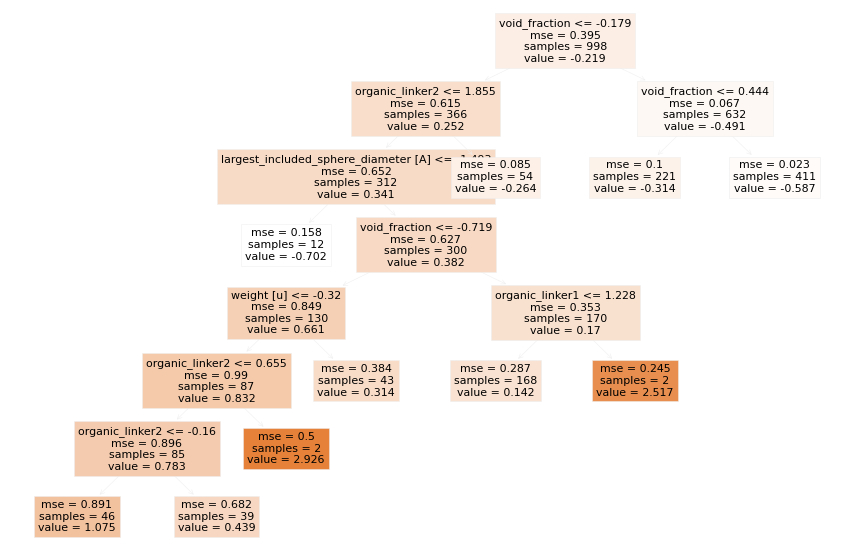

In [ ]:
#Plot Random Forest Tree
import matplotlib.pyplot as plt
from sklearn.tree import plot_tree

filtered_df1 = filtered_df.drop(columns=[ 'CO2/N2_selectivity'])
filtered_df1 = filtered_df.drop(columns=['CO2_uptake_P0.15bar_T298K [mmol/g]'])
fig = plt.figure(figsize=(15, 10))
plot_tree(model.estimators_[1], feature_names= filtered_df1.columns, class_names= 'CO2_uptake_P0.15bar_T298K [mmol/g]', filled=True, impurity=True, fontsize=11)


In [ ]:
import matplotlib.pyplot as plt
plt.style.use('ggplot')

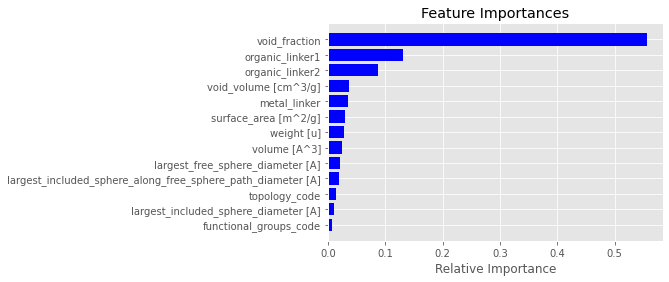

In [ ]:
# plot the feature importances
features = X_train1.columns
importances = model.feature_importances_
indices = np.argsort(importances)[-20:]  # top 10 features
plt.title('Feature Importances')
plt.barh(range(len(indices)), importances[indices], color='b', align='center')
plt.yticks(range(len(indices)), [features[i] for i in indices])
plt.xlabel('Relative Importance')
plt.show()

# Neural Networks

In [ ]:
from keras.models import Sequential
from keras.layers import Dense
import numpy as np
import matplotlib.pyplot as plt

from sklearn.metrics import accuracy_score


#Define keras model with sequential network 
model = Sequential()
model.add(Dense(28, input_shape=(14,), activation='relu', use_bias=True))
#model.add(Dense(14, activation='relu'))
#model.add(Dense(10, activation='relu'))
#model.add(Dense(6, activation='relu'))
model.add(Dense(1, activation='linear'))

#Compile keras model
model.compile(loss='mean_squared_error', optimizer='sgd', metrics=["accuracy"])

#Fit keras model with 50 epochs and 50 batches
history = model.fit(X_train, y_train, epochs=50, batch_size=50, verbose=1, validation_data=(X_test, y_test))

#Evaluate keras model
train_mse = model.evaluate(X_train, y_train, verbose=0)
test_mse = model.evaluate(X_test, y_test, verbose=0)
print('Train: %.3f, Test: %.3f' % (np.mean(train_mse), np.mean(test_mse)))


y_pred = model.predict(X_test)
a = accuracy_score(y_pred, y_test)
#print('Accuracy is: ', a*100)


#plot loss during training
plt.title('Loss/Mean Squared Error')
plt.plot(history.history['loss'], label='train')
plt.plot(history.history['val_loss'], label='test')
plt.legend()
plt.show()

Epoch 1/50
4350/4350 [==============================] - 5s 1ms/step - loss: 0.2022 - accuracy: 0.0000e+00 - val_loss: 0.1604 - val_accuracy: 0.0000e+00
Epoch 2/50
4350/4350 [==============================] - 5s 1ms/step - loss: 0.1296 - accuracy: 0.0000e+00 - val_loss: 0.1115 - val_accuracy: 0.0000e+00
Epoch 3/50
4350/4350 [==============================] - 5s 1ms/step - loss: 0.1023 - accuracy: 0.0000e+00 - val_loss: 0.1009 - val_accuracy: 0.0000e+00
Epoch 4/50
4350/4350 [==============================] - 4s 995us/step - loss: 0.0965 - accuracy: 0.0000e+00 - val_loss: 0.0960 - val_accuracy: 0.0000e+00
Epoch 5/50
4350/4350 [==============================] - 4s 1ms/step - loss: 0.0936 - accuracy: 0.0000e+00 - val_loss: 0.1066 - val_accuracy: 0.0000e+00
Epoch 6/50
4350/4350 [==============================] - 4s 1ms/step - loss: 0.0910 - accuracy: 0.0000e+00 - val_loss: 0.0905 - val_accuracy: 0.0000e+00
Epoch 7/50
4350/4350 [==============================] - 5s 1ms/step - loss: 0.0884 - a

ValueError: ignored